# UP221 Midterm Project

### Group Name: Motor City Motor Equity
### Group Member: Akshay Jalluri
## Overview: 
For this assignment, I will be fixing up the messiest parts of my code (which all happen to be around the same area of the code) by utilizing more functions and for loops

All the sections I made updates to will have the section titles be in <font color='red'> <b> red

In [47]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import plotly.express as px   # New one for making these interactive plots 

In [48]:
dataMichigan = pd.read_csv('data/RaceInMichigan.csv', dtype = {'FIPS': str})

In [49]:
dataMichigan.shape             # This shows the dimension of the dataframe, 3017 entries and 322 columns

(3017, 322)

In [50]:
dataMichigan.sample(3)            # This just gives a sample of the first 5 rows just to see the format of the table without taking too much room

,FIPS,NAME,DP1_0001C,DP1_0002C,DP1_0003C,DP1_0004C,DP1_0005C,DP1_0006C,DP1_0007C,DP1_0008C,...,DP1_0151P,DP1_0152P,DP1_0153P,DP1_0154P,DP1_0155P,DP1_0156P,DP1_0157P,DP1_0158P,DP1_0159P,DP1_0160P
2127,26145012400,Census Tract 124; Saginaw County; Michigan,1842,86,102,104,118,79,84,84,...,0.1,0.8,0.8,1.2,1.7,(X),(X),100,93,7
2225,26155030600,Census Tract 306; Shiawassee County; Michigan,1786,111,113,123,107,151,164,162,...,0.1,1.5,0.9,0.1,7.3,(X),(X),100,26.1,73.9
1875,26125183300,Census Tract 1833; Oakland County; Michigan,2964,124,87,102,103,159,451,362,...,0.2,0.8,0.5,1.2,1.3,(X),(X),100,70.6,29.4


In [51]:
dataMichigan.info()                                                # We now know the data type of each column of data

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3017 entries, 0 to 3016
Columns: 322 entries, FIPS to DP1_0160P
dtypes: float64(2), int64(155), object(165)
memory usage: 7.4+ MB


In [52]:
dataMichigan.columns[dataMichigan.isna().all()].tolist()           # We are checking to see if there are any columns with all blank values

[]

Looks like there is no empty columns, as seen in the statement printed statement above, so no need to drop any of them

## Setting Up & Filtering Data

Since we only care about race, and not the other columns that are shown in here like gender, age, marital status, etc. we will only keep columns that include relevent information about race. Here is what each column we are keeping means:
- FIPS = Geographic area
- DP1_0076C = Total population 
- DP1_0086C = White population (both alone and in combination with other races included)
- DP1_0087C = Black population (both alone and in combination with other races included)
- DP1_0088C = American Indian & Alaska Native population (both alone and in combination with other races included)
- DP1_0089C = Asian population (both alone and in combination with other races included)
- DP1_0090C = Native Hawaiian & Other Pacific Islander population (both alone and in combination with other races included)
- DP1_0096C = Hispanic or Latino (both alone and in combination with other races included)

In [53]:
race_columns = ['FIPS', 'DP1_0076C', 'DP1_0105C', 'DP1_0087C', 'DP1_0088C', 'DP1_0089C', 'DP1_0090C', 'DP1_0096C']                     # Making a array of all the columns from dataMichigan that I want to keep

raceMichigan = dataMichigan[race_columns]                   # Making a new dataframe that will only include the relevent race
raceMichigan.sample(3)

,FIPS,DP1_0076C,DP1_0105C,DP1_0087C,DP1_0088C,DP1_0089C,DP1_0090C,DP1_0096C
2154,26147636000,4576,3459,708,138,33,8,253
1795,26125161200,5005,756,4081,68,123,3,62
2360,26161446200,2252,2046,41,39,38,1,74


Ideally, you would want the sum of all the populations of each race to add up to the total population in the census track. However, if you look through the rows, you will see that the sum of all these populations exceed the total population. The reason for this is that those of multiple races will count in multiple race categories, hence double/triple counting them when adding them up. So, don't worry about the sums not adding up to the total population, that detail will not affect any of the results of this analysis.

In [54]:
# Renaming the column headers to names that make sense to a reader
raceMichigan.columns = ['FIPS', 'Total Population', 'White', 'Black', 'Native American', 'Asian', 'Pacific Islander', 'Hispanic or Latino']
raceMichigan.sample(3)

,FIPS,Total Population,White,Black,Native American,Asian,Pacific Islander,Hispanic or Latino
2901,26163583800,4540,3230,778,109,143,1,298
607,26063951100,2185,2053,9,43,17,2,52
1597,26123971000,4999,4435,38,112,38,6,303


We now want to narrow it down into just metro-Detroit, not the whole state of Michigan. For our analysis, we will only look at the 3 main counties that comprise of metro-Detroit, which is Wayne County, Oakland County, and Macomb County. The FIPS county code for Wayne County is 163, Oakland County is 125, and for Macomb County is 099. Since the FIPS state code is 26, the format is state then county code, we only want to include FIPS codes that start with 26163, 26125, and 26099 

In [55]:
counties = raceMichigan['FIPS'].str[2:5].to_numpy()                        # Make a new array of all the county codes for each row
raceMichigan.insert(loc=1, column='County', value=counties)                # Add the county codes to the dataframe into the column right next to FIPS column
raceMichigan.head(3)

,FIPS,County,Total Population,White,Black,Native American,Asian,Pacific Islander,Hispanic or Latino
0,26001000100,001,1690,1630,11,25,5,0,14
1,26001970100,001,2340,2168,23,45,15,4,46
2,26001970400,001,2833,2688,32,71,13,2,18


In [56]:
# Only including rows where the county codes are 163 (Wayne County), 125 (Oakland County), and 099 (Macomb County)
raceMetroDetroit = raceMichigan[raceMichigan['County'].isin(['163','125','099'])]

# Renaming the county codes into the names of the actual county itself to increase readability
raceMetroDetroit.loc[:,'County'] = raceMetroDetroit['County'].replace({'163': 'Wayne', '125': 'Oakland', '099': 'Macomb'})

# Resetting the row indexing to start from 0
raceMetroDetroit.reset_index(drop=True, inplace=True)
raceMetroDetroit.sample(7)

,FIPS,County,Total Population,White,Black,Native American,Asian,Pacific Islander,Hispanic or Latino
1091,26163580400,Wayne,2594,2244,68,74,36,1,160
890,26163554500,Wayne,2766,1314,1227,70,54,0,110
27,26099222800,Macomb,3119,2744,162,65,70,1,51
582,26125197701,Oakland,5304,2295,299,47,2429,2,210
408,26125156000,Oakland,2710,2171,242,24,184,0,79
657,26163511900,Wayne,1559,314,1153,37,45,5,45
721,26163525900,Wayne,2610,280,577,128,21,0,1752


Now we have all the data needed in order to conduct an analysis on racial profile in metro-Detroit

## Racial Profile of Detroit</font>

Let's start off by doing a racial profile by county and see the racial distributions within each county. We will also make a stacked bar chart to better visualize the racial profile

In [57]:
raceMetroDetroit['Total Population'].describe()            # This shows statistical information about total populaiton within a census track within metro-Detroit

count    1221.000000
mean     3234.375921
std      1571.221283
min         0.000000
25%      2220.000000
50%      3110.000000
75%      4160.000000
max      9049.000000
Name: Total Population, dtype: float64

In [58]:
# Before, we had all the formulas for each combination of race and county written out. Now, we were able to simplify it into making our own function 

def countyracecount(county, race):
    count = raceMetroDetroit.loc[raceMetroDetroit['County'] == county, race].sum()          # Runs the formula
    name = county + race                           # Make a string that combines the the county name and race
    name = name.replace(" ", "")                   # Remove any spaces so that it can become a valid variable name in the future
    return [count, name]


# These are the list of all the counties and races
counties = ['Wayne', 'Oakland', 'Macomb']
races = ['White', 'Black', 'Asian', 'Hispanic or Latino', 'Native American', 'Pacific Islander']

populations = []
countyRaces = []

for county in counties:
    for race in races:
        population, countyRace = countyracecount(county, race)
        populations.append(population)
        countyRaces.append(countyRace)        

Now we can plot this data into a stacked bar chart with each of the 3 bars being each county, and having each section within a bar being their race

## Make it into an Interactive Plotly Plot
Making the new dataset into a forloop rather than manually typing them out. Also, we changed it to a interactive plotly plot

In [59]:
# We must make a new dataset with only the information that is needed for the interactive chart
# This only includes the data that we need, which is the population totals for each race and for each county. So we can delete the FIPS column
# We can make use of all the math we did above for getting the population sums for each race in each county and make a new dataframe out of it

countiesRace = {}

for i in range(len(races)):
    list = {races[i] : [populations[i], populations[i+6], populations[i+12]]}
    countiesRace.update(list)

countiesRace = pd.DataFrame(countiesRace, index=counties)
countiesRace

,White,Black,Asian,Hispanic or Latino,Native American,Pacific Islander
Wayne,857132,712698,79719,117649,35132,1975
Oakland,879137,188810,120040,60838,21387,1080
Macomb,665241,123254,46283,26214,16388,881


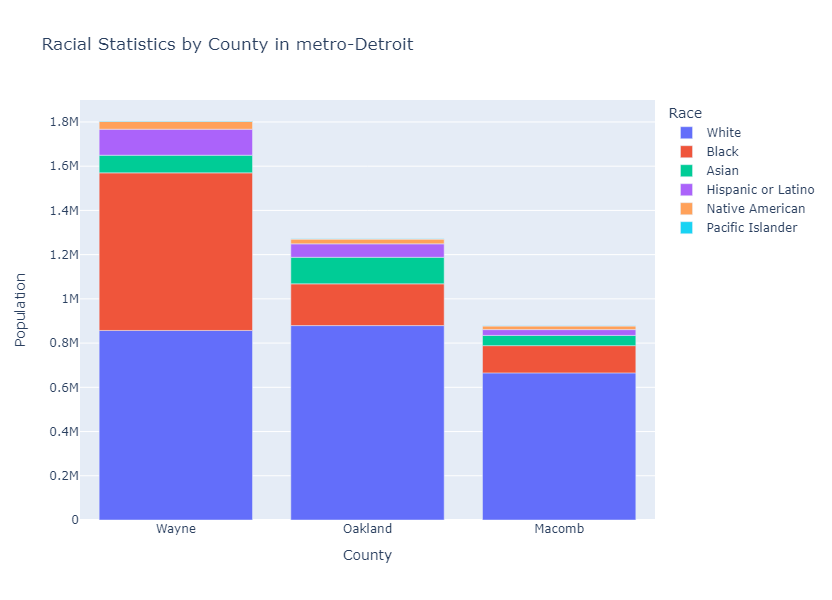

In [60]:
# <ake a stacked bar chart. This is in a wide dataset format, so we must use the px.bar syntax that accomodates for this type of dataframe
fig = px.bar(countiesRace, 
             x = counties,
             y = countiesRace.columns.tolist(),
             title = "Racial Statistics by County in metro-Detroit",
             width=1000, 
             height=600,
             labels={'x':'County' , 'value':'Population'})

fig.update_layout(legend_title_text='Race')

fig.show()


As you see, the majority of the Black population is in Wayne County, almost equallying that of the White population. Wayne County is also where the city of Detroit is as well. The Black population in Oakland and Macomb counties are much smaller than that of Wayne County. There also seems to be a greater Hispanic over Asian population in Wayne County too as opposed to Oakland and Macomb Counties. The Native American/Alaska Native and Native Hawaiian/Pacific Islander populations are very small in all 3 counties, as expected. For the midterm project on transportation equity in metro-Detroit, this graph can give us a general idea of where the different racial populations are on a county level.

Next, let's dive deeper into trying to find correlations between the races on an individual cencus tract level.

## Quantifying Racial Segregation using Index of Dissimilarity

We can look at Index of Dissimilarity (D), which is the most common measure of segregation. The larger the number, the more segregation there is. To find this Index of Dissimilarity, we use this formula.
$$ D = \dfrac{1}{2}\Sigma^{n}_{i=1} |\dfrac{a_i}{A_T} - \dfrac{b_i}{B_T}| $$
where $n$ is number of census tracts, $a_i$ is population of race a in tract i, $A_T$ is total population of race a, $b_i$ is population of race b in tract i, $B_T$ is total population of race b 
We can also make a map of each single dissimilarity index for each census tract for each race combination

Let's compare segregation of White population vs Black population, White population vs Asian population, and White population vs Hispanic population. From visual inspection of the table, I decided to not include Native American or Pacific Islander comparisons because those populations are too small to make an accurate judgement of the measure of segregation.

In [61]:
# Before, we had all the formulas for each combination of race and county written out. Now, we were able to simplify it into making our own function

def IndexDissimilarity(race):
    totalWhite = raceMetroDetroit['White'].sum()                                  # First find total of White population. We sum the values from each of the rows within the White columns
    proportion = []                                                               # Creating an empty list that will get added onto later
    
    for i in range(len(raceMetroDetroit)):                                        # Creating a for-loop that iterates through each of the rows and adds onto the above array. i is the index of the particular tract 
        a = raceMetroDetroit.loc[i,'White']                                       # In dissimilarity formula, a is the population of one race within the certain cencus tract, which in this case is tract i, as it iterates through all of them
        b = raceMetroDetroit.loc[i, race]                                         # In dissimilarity formula, b is the population of the other race within the certain cencus tract, which in this case is tract i, as it iterates through all of them
        value = abs((a/totalWhite) - (b/raceMetroDetroit[race].sum()))            # This is the |(a_i/A_T) - (b_i/B_T)| part of the formula and it yields the value for the particular cencus tract
        proportion.append(value)                                                  # That value now gets appended to the array, which will keep adding on as it iterates thorugh each census tract
    indexDissimilarity = 100 * 0.5 * sum(proportion)                              # All the values of the array need to be summed as the formula requires a summation and the 100x is to convert to percentage
    return round(indexDissimilarity, 2)

dissimilarity = []                                                                # This will be used for later when plotting

for i in range(1,4):                                                              # I chose range(1,4) because we are excluding "White" because we are only focusing on minorities and comparing them to whites
    index = IndexDissimilarity(races[i])                                          # Calling the IndexDissimilarity function
    dissimilarity.append(index)                                                   # Adding each of the index values to the dissimilarity list above
    print('The Index of Dissimilarity of White vs ' + str(races[i]) + ' population is: ' + str(index) + '%')    # Printing out the values

The Index of Dissimilarity of White vs Black population is: 68.02%
The Index of Dissimilarity of White vs Asian population is: 45.35%
The Index of Dissimilarity of White vs Hispanic or Latino population is: 40.52%


What does the Index of Dissimilarity mean. Since we got 68.02% for White vs Black population, this would mean that 68.02% of Blacks would need to move in order to achieve a uniform distribution by race. That is a lot of people that would have to move, that just shows how un-uniform and segregated current metro-Detroit is right now.

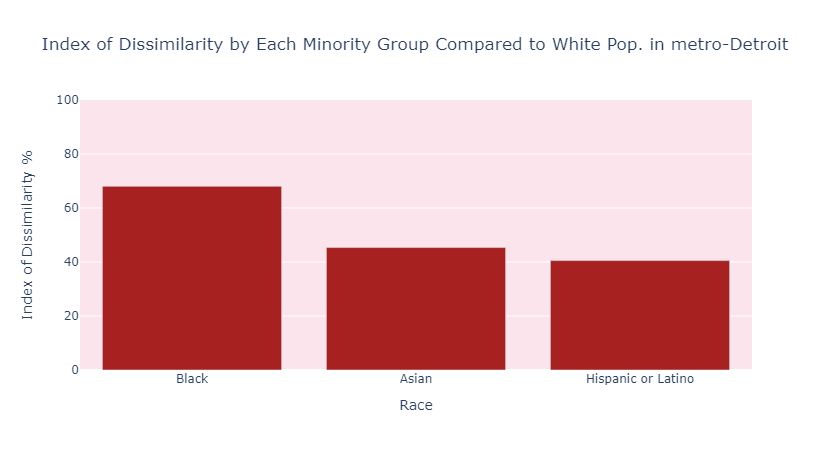

In [62]:
# When making a plotly graph, we must put our data into a dataframe
rows = races[1:4]                                           # Naming our rows by the 3 races we are looking at, Black, Asian, Hispanic
dissimilarityRace = pd.DataFrame(index = rows)              # Making it into a dataframe
dissimilarityRace['Index of Dissimilarity'] = dissimilarity     # Adding dissimilarity values to the dataframe

# Now making an interactive plotly graph out of this
fig = px.bar(dissimilarityRace, 
             labels= {'index':'Race', 'value':'Index of Dissimilarity %'},
             width=800, 
             height=450,
             title = "Index of Dissimilarity by Each Minority Group Compared to White Pop. in metro-Detroit",
             color_discrete_sequence=['#a82121'])                        # changing the color so that it matches the theme of my slideshow 

# Removing the legend and making the y-axis of the graph go up to 100% to better show percentages
fig.update_layout(showlegend = False)
fig.update_layout(plot_bgcolor='#fce4ec')
fig.update_yaxes(range=[0, 100])

fig.show()

## Setting up and Filtering GeoData

In [63]:
import geopandas as gpd                                            # In order to map geographical coordinates, we need to import the geopandas library

In [64]:
michiganTracts = gpd.read_file('data/tl_2020_26_tract.zip')        # Reading in the geojson file of Michigan with the geometries of the cencus track boundaries
michiganTracts.sample(2)                  

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
2566,26,125,136102,26125136102,1361.02,Census Tract 1361.02,G5020,S,2095536,87394,+42.5158001,-083.5057354,"POLYGON ((-83.51765 42.52493, -83.51631 42.524..."
2228,26,125,142600,26125142600,1426,Census Tract 1426,G5020,S,2112028,86631,+42.6282783,-083.3193262,"POLYGON ((-83.33447 42.63033, -83.33422 42.630..."


Now we need to filter out the rows so that it only includes the metro-Detroit region which comprise of Wayne County (163), Oakland County (125), and Macomb County (099)

In [65]:
metroDetroitTracts = michiganTracts[michiganTracts['COUNTYFP'].isin(['163','125','099'])]    # Keeping only rows with CountyFP = 163, 125, and 099
metroDetroitTracts.sample(2)

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
313,26,163,588002,26163588002,5880.02,Census Tract 5880.02,G5020,S,1341301,6360,+42.2276748,-083.4495526,"POLYGON ((-83.45478 42.23454, -83.45359 42.234..."
1173,26,163,519000,26163519000,5190,Census Tract 5190,G5020,S,2157806,0,+42.3614292,-083.0345625,"POLYGON ((-83.04631 42.36370, -83.04610 42.363..."


We are going to merge this tract data with the raceMetroDetroit dataframe so that all the data is in one dataframe. To be able to do the merge, we are going to select the column in which we will be able to do the merge, which in this case will be the FIPS code. To be able to do a merge, the column we are merging on has to contain the same name in both dataframes. In raceMetroDetroit dataframe it is called "FIPS" and in metroDetroitTracts it is called "GEOID". So I must change that.


In [66]:
# Change the column header in metroDetroitTracts dataframe from "GEOID" to "FIPS"
metroDetroitTracts.rename(columns = {'GEOID':'FIPS'}, inplace = True)

# Now merge this dataframe to the raceMetroDetroit dataframe
metroDetroitTracts_race = metroDetroitTracts.merge(raceMetroDetroit, on='FIPS')

# Removing the columns we don't need
metroDetroitTracts_race.drop(columns = ['STATEFP', 'COUNTYFP', 'NAME', 'NAMELSAD', 'MTFCC', 'FUNCSTAT', 'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON'], inplace = True)

metroDetroitTracts_race.sample(5)

/tmp/ipykernel_3517/2293766603.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,TRACTCE,FIPS,geometry,County,Total Population,White,Black,Native American,Asian,Pacific Islander,Hispanic or Latino
167,231000,26099231000,"POLYGON ((-83.01359 42.59538, -83.01342 42.595...",Macomb,4303,3659,244,57,193,5,133
187,542300,26163542300,"POLYGON ((-83.21839 42.40112, -83.21820 42.401...",Wayne,2255,40,2177,49,13,1,32
475,583001,26163583001,"POLYGON ((-83.27039 42.26536, -83.27038 42.265...",Wayne,2568,1922,220,107,61,2,245
688,138301,26125138301,"POLYGON ((-83.67075 42.51728, -83.67062 42.517...",Oakland,4492,3788,116,82,222,2,236
464,553601,26163553601,"POLYGON ((-83.09556 42.40330, -83.09364 42.404...",Wayne,1931,148,1738,53,12,7,48


Now we have all the data in place to be able to make maps. Let's plot it and find the distribution of each race within metro-Detroit

## Mapping the GeoData

### <font color='red'> Change
<font color='red'> Converted it into a for loop.

Although we now have all the data we need, before we map it it is better to look 

In [67]:
# Here is the change we made with the above lines of commented out code to improve upon it
racesMain = races[:4]
for i in racesMain:
    metroDetroitTracts_race[f'PCT_{i}'] = metroDetroitTracts_race[i]/metroDetroitTracts_race['Total Population']*100

### <font color='red'> Change
<font color='red'> Converted it into a function and for loop to reduce lines of code.

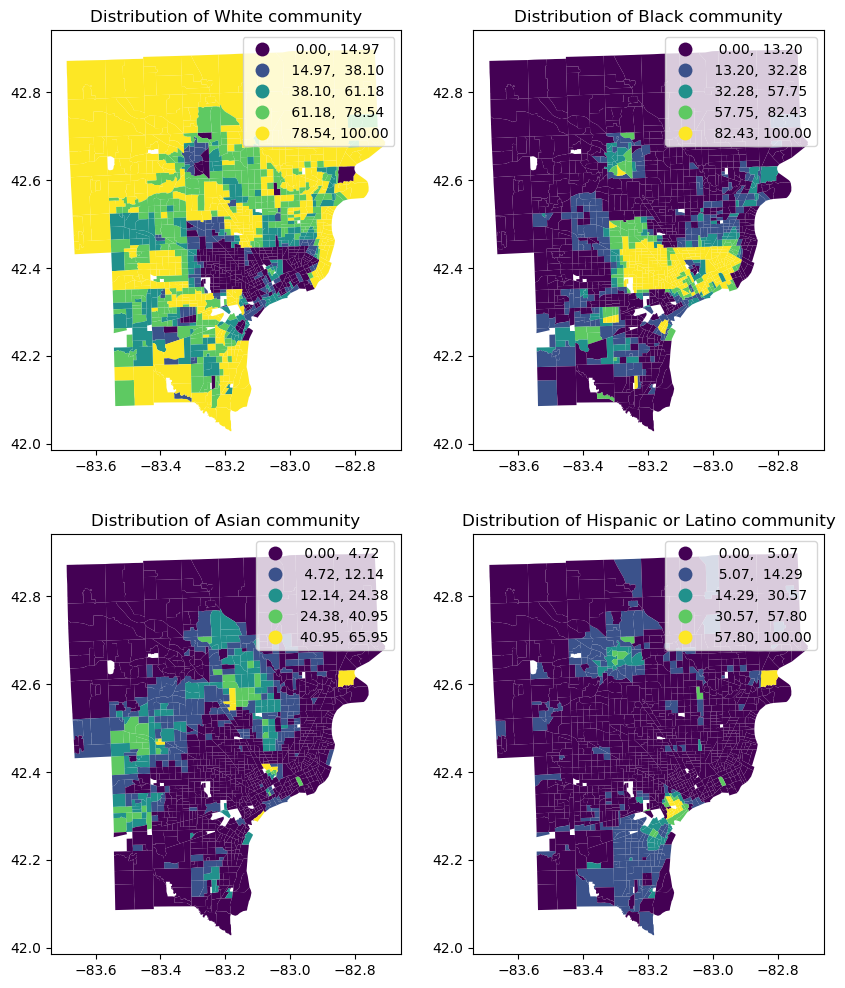

In [68]:
# Creating a function for plotting the graphs
def plotDistribution(ax, column, title):
    metroDetroitTracts_race.plot(ax=ax, column=column, legend=True, scheme='NaturalBreaks')    # This is how we plot the map
    ax.set_title(title)         # Making the title for the map

fig, axs = plt.subplots(2, 2, figsize=(10, 12))      # Creating the subplots

# Now creating the for loop that creates the subplot for each group using the plotDistribution function above
for i in racesMain:
    row = racesMain.index(i) // 2       # Using a floor division operator to get row number so that it is 0,0,1,1
    column = racesMain.index(i) % 2     # Using a mod function to get column number so that it is 0,1,0,1
    columnName = f'PCT_{i}'             # Using the columns PCT_White, PCT_Black, etc. from the dataset
    title = f'Distribution of {i} community'
    plotDistribution(axs[row,column] , columnName , title)  # Calling the plotDistribution function 


We did that Index of Dissimilarity Analysis before, but now we can actually map that data. Rather than creating seperate maps for White community distribution and black community distribution, we can now create a map that indicates the segregation between White and Black communtiies. From the Index of Dissimilarity formula, we can make use of $\dfrac{a_i}{A_T} - \dfrac{b_i}{B_T}$ term in the formula where $a_i$ is population of race a in tract i, $A_T$ is total population of race a, $b_i$ is population of race b in tract i, $B_T$ is total population of race b.

This term is very powerful, because a value of 0 means that there is equal proportion of the races within the census track. For example, say that there is 200 White people in the whole city and 100 Black people in the whole city. Looking within one census tract within the city, if there is 20 White people in the census tract, for there to be no segregation, there should be 10 Black people within that same census tract, as both 10% of White people and 10% of Black people of the city would be living within the census tract. Plugging these numbers into the formula term $\dfrac{a_i}{A_T} - \dfrac{b_i}{B_T}$ will become $\dfrac{20}{200} - \dfrac{10}{100} $ which is $0$.

If the term yields a positive number, it would indicate that there are proportionally more of race A, and if the term yields a negative number, it would indicate that therer are proportionally more of race B.

### <font color='red'> Change
<font color='red'> Utilized a funciton and multiple for loops to reduce lines of code.

In [72]:
def dissimilarityArray(race2, totalPopulation, data):
    totalWhite = totalPopulation['White']                     # Making an array of total white population of each cencus tract
    totalRace2 = totalPopulation[race2]                       # Making an array of total other population which will be inputted into this function
    dissimilarityValues = []                                  # Creating an empty list to which we will add to later
    
    for i in range(len(data)):                                # Creating a for loop that will loop through each census tract and calculate index of dissimilarity of it for that particular race                 
        a = data.loc[i, 'White']                              # Going to row number (cencus tract index) and column (race) and getting population value from it
        b = data.loc[i, race2]                                # Same on this one but not for white but for the other race
        value = (a/totalWhite) - (b/totalRace2)               # Calculating the value based on the dissimilarity formula for that particular race for that particular census tract
        dissimilarityValues.append(value)                     # Adding that to the array. So in the end there will be an array of values for all census tracts for that particular race

    return dissimilarityValues

otherRaces = racesMain[1:]                                    # These will be the races we will be comparing White to
totalPopulation = {}                                          

for i in racesMain:
    totalPopulation[i] = metroDetroitTracts_race[i].sum()     # We now have total population numbers of each race

dissimilarityResults = {}                                     # Creating a new dictionary of dissimilarity results

for i in otherRaces:                                          # Creating a new for loop that will iterate through the list of races that will each run the dissimilarity function
  label = f'White{i}'                                         # Creating labels like WhiteBlack, WhiteAsian, etc.
  dissimilarity = dissimilarityArray(i, totalPopulation, metroDetroitTracts_race)     # Calling the dissimilarity function that we made above
  dissimilarityResults[label] = dissimilarity                 # Associating each dissimilarity list with its correct race

In [73]:
# Adding this array as a new column in the metroDetroitTracts_race dataframe and naming it as metroDetroitTracts_dissimRace
metroDetroitTracts_dissimRace = metroDetroitTracts_race.copy()                          # Making a copy of the existing dataframe
metroDetroitTracts_dissimRace['WhiteBlack Dissimilarity'] = WhiteBlack                  # Adding a new column to the new dataframe and inserting the WhiteBlack array from above into that column
metroDetroitTracts_dissimRace['WhiteAsian Dissimilarity'] = WhiteAsian                  # Adding a new column to the new dataframe and inserting the WhiteAsian array from above into that column
metroDetroitTracts_dissimRace['WhiteHispanic Dissimilarity'] = WhiteHispanic            # Adding a new column to the new dataframe and inserting the WhiteHispanic array from above into that column

metroDetroitTracts_dissimRace.sample(5)

,TRACTCE,FIPS,geometry,County,Total Population,White,Black,Native American,Asian,Pacific Islander,Hispanic or Latino,PCT_White,PCT_Black,PCT_Asian,PCT_Hispanic or Latino,WhiteBlack Dissimilarity,WhiteAsian Dissimilarity,WhiteHispanic Dissimilarity
493,166900,26125166900,"POLYGON ((-83.35846 42.49599, -83.35398 42.496...",Oakland,3529,2363,667,71,334,4,100,66.959479,18.900538,9.464438,2.833664,0.000333,-0.000374,0.000495
12,241000,26099241000,"POLYGON ((-82.89175 42.56980, -82.89161 42.570...",Macomb,4536,2724,1527,81,118,3,91,60.052910,33.664021,2.601411,2.006173,-0.000356,0.000655,0.000690
974,218001,26099218001,"POLYGON ((-82.81192 42.73541, -82.81165 42.735...",Macomb,6097,4299,1142,200,101,8,391,70.510087,18.730523,1.656552,6.412990,0.000676,0.001380,-0.000120
1123,263400,26099263400,"POLYGON ((-83.06517 42.47673, -83.06280 42.476...",Macomb,4035,2199,658,89,954,5,134,54.498141,16.307311,23.643123,3.320942,0.000274,-0.002962,0.000261
144,539200,26163539200,"POLYGON ((-83.20334 42.44475, -83.20330 42.444...",Wayne,4863,73,4727,66,19,3,55,1.501131,97.203372,0.390705,1.130989,-0.004582,-0.000047,-0.000238


Text(0.5, 1.0, 'Distribution of White and Black Populations in Metro-Detroit')

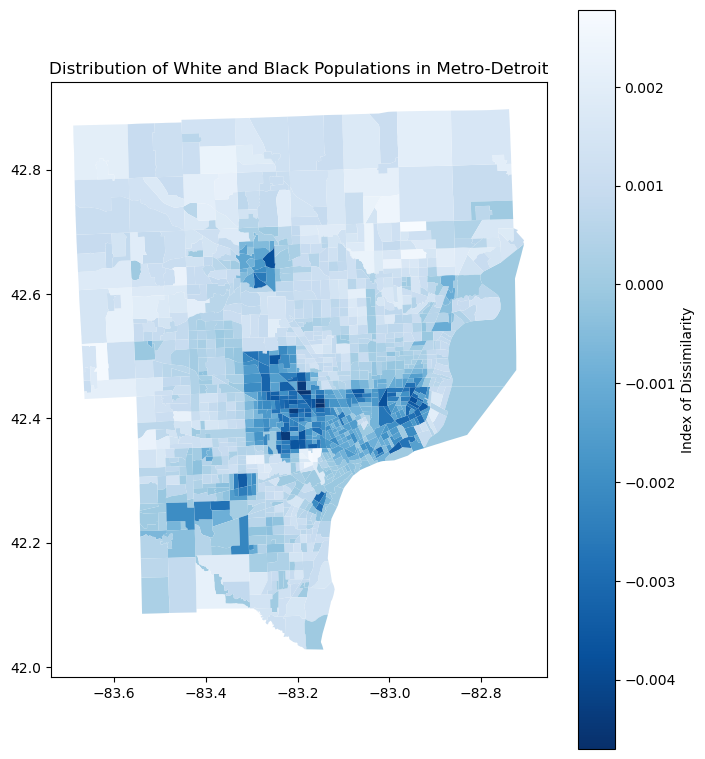

In [29]:
# Plotting the dissimilarity between White and Black community in metro-Detroit
metroDetroitTracts_dissimRace.plot(figsize=(8,9.6), 
                                   column = 'WhiteBlack Dissimilarity', 
                                   legend = True, cmap = 'Blues_r', 
                                   legend_kwds={"label": "Index of Dissimilarity"})
plt.title('Distribution of White and Black Populations in Metro-Detroit')

Looking at this map above, we can see the areas that are more prodominantly White and areas that are prodominantly Black. We used the Index of Dissimilarity measure to obtain this. When doing transportation analysis in this area, we will need to keep these these racial disparities in mind

Now we can make an interactive version of this map using Folium. We will also import in the bus stops while we are at it too

## Adding Bus Stop Data

In [26]:
smartBus = pd.read_csv("data/SMART_Bus_Stops.csv", usecols = ['stop_name', 'stop_lat', 'stop_lon', 'ObjectId'])
ddot = pd.read_csv("data/DDOT_Bus_Stops_(Current).csv", usecols = ['OBJECTID', 'Loca_latitude', 'Loca_longitude', 'Description'])

In [27]:
smartBus.sample(3)

,stop_name,stop_lat,stop_lon,ObjectId
4196,SCHOENHERR & PLUMBROOK,42.574808,-82.989401,4197
2910,12 MILE RD @ EVERGREEN NE,42.502075,-83.241378,2911
2718,TELEGRAPH @ DEDHAM CT,42.586006,-83.280940,2719


In [28]:
ddot.sample(3)

,OBJECTID,Loca_latitude,Loca_longitude,Description
733,734,42.432722,-83.090173,7 Mile & Hanna
853,854,42.417690,-82.911825,Moross & Mack
3379,3380,42.408709,-83.198565,Puritan & Greenfield


In [29]:
import folium
from folium import plugins

In [30]:
# Creating basemap
m = folium.Map(location = [42.3317,-83.0471],
               zoom_start = 9,
               tiles='CartoDB positron', 
               attribution='CartoDB')


# Now adding our WhiteBlack dissimilarity data on top
folium.Choropleth(geo_data = metroDetroitTracts_dissimRace,            # geo data
                  data = metroDetroitTracts_dissimRace,                # data
                  key_on='feature.properties.FIPS',                    # key, or merge column
                  columns=['FIPS', 'WhiteBlack Dissimilarity'],        # [key, value]
                  fill_color='Blues_r',
                  line_weight=0.1,
                  fill_opacity=0.8,
                  line_opacity=0.2,                                    # line opacity (of the border)
                  legend_name='Index of Dissimilarity for White & Black Communities',
                  name = "WhiteBlack Dissimilarity").add_to(m)         # name on the legend color bar

# Now adding our WhiteAsian dissimilarity data on top
folium.Choropleth(geo_data = metroDetroitTracts_dissimRace,            # geo data
                  data = metroDetroitTracts_dissimRace,                # data
                  key_on='feature.properties.FIPS',                    # key, or merge column
                  columns=['FIPS', 'WhiteAsian Dissimilarity'],        # [key, value]
                  fill_color='Greens_r',
                  line_weight=0.1,
                  fill_opacity=0.8,
                  line_opacity=0.2,                                    # line opacity (of the border)
                  legend_name='Index of Dissimilarity for White & Asian Communities',
                  name = "WhiteAsian Dissimilarity").add_to(m)         # name on the legend color bar

# Now adding our WhiteHispanic dissimilarity data on top
folium.Choropleth(geo_data = metroDetroitTracts_dissimRace,            # geo data
                  data = metroDetroitTracts_dissimRace,                # data
                  key_on='feature.properties.FIPS',                    # key, or merge column
                  columns=['FIPS', 'WhiteHispanic Dissimilarity'],     # [key, value]
                  fill_color='Purples_r',
                  line_weight=0.1,
                  fill_opacity=0.8,
                  line_opacity=0.2,                                    # line opacity (of the border)
                  legend_name='Index of Dissimilarity for White & Hispanic Communities',
                  name = "WhiteHispanic Dissimilarity").add_to(m)      # name on the legend color bar


# Now mapping the DDOT Bus stop and SMART Bus stop points into the Folium Map

feature_gp1 = folium.FeatureGroup(name="DDOT")
feature_gp2 = folium.FeatureGroup(name="SMART")

for i in range(len(ddot['OBJECTID'])):
    folium.CircleMarker(location= [ddot['Loca_latitude'][i] , ddot['Loca_longitude'][i]],
                        radius=0.05,
                        color='#0C5449',
                        fill=True,
                        fill_color='#0C5449',
                        name = "DDOT").add_to(feature_gp1)


for i in range(len(smartBus['ObjectId'])):
    folium.CircleMarker(location= [smartBus['stop_lat'][i] , smartBus['stop_lon'][i]],
                        name = 'SMART',
                        radius=0.05,
                        color='#990000',
                        fill=True,
                        fill_color='#990000').add_to(feature_gp2)

feature_gp1.add_to(m)
feature_gp2.add_to(m)

minimap = plugins.MiniMap()
m.add_child(minimap)

folium.LayerControl(position='topright', collapsed=True, autoZIndex=True).add_to(m)

m

## Analysis of Transit Overserved and Transit Underserved Areas

Since the Index of Dissimilarity is the most for the Black community as seen before, we will focus only on that

In [31]:
from shapely.geometry import Point

In [32]:
metroDetroitTracts_dissimRace

,TRACTCE,FIPS,geometry,County,Total Population,White,Black,Native American,Asian,Pacific Islander,Hispanic or Latino,PCT_Black,PCT_White,PCT_Asian,PCT_Hispanic,WhiteBlack Dissimilarity,WhiteAsian Dissimilarity,WhiteHispanic Dissimilarity
0,591900,26163591900,"POLYGON ((-83.24385 42.08143, -83.24375 42.081...",Wayne,5305,4115,504,166,139,2,342,9.500471,77.568332,2.620170,6.446748,0.001222,0.001149,0.000043
1,592000,26163592000,"POLYGON ((-83.23187 42.07831, -83.23075 42.079...",Wayne,4689,3732,323,138,188,6,259,6.888462,79.590531,4.009384,5.523566,0.001239,0.000790,0.000289
2,593200,26163593200,"POLYGON ((-83.25654 42.15356, -83.25327 42.153...",Wayne,3931,3045,303,79,162,4,302,7.707962,77.461206,4.121089,7.682524,0.000972,0.000610,-0.000207
3,594000,26163594000,"POLYGON ((-83.18951 42.14131, -83.18868 42.142...",Wayne,2532,2151,117,71,32,1,145,4.620853,84.952607,1.263823,5.726698,0.000782,0.000766,0.000187
4,594100,26163594100,"POLYGON ((-83.20697 42.14824, -83.20675 42.150...",Wayne,4387,3948,59,112,48,3,188,1.344883,89.993162,1.094142,4.285389,0.001586,0.001449,0.000726
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1216,224201,26099224201,"POLYGON ((-82.93643 42.64269, -82.93348 42.642...",Macomb,3858,3198,251,55,207,1,127,6.505962,82.892691,5.365474,3.291861,0.001087,0.000490,0.000711
1217,224101,26099224101,"POLYGON ((-82.91728 42.65786, -82.91479 42.657...",Macomb,4430,3654,332,57,234,3,117,7.494357,82.483070,5.282167,2.641084,0.001198,0.000570,0.000950
1218,224202,26099224202,"POLYGON ((-82.91659 42.64316, -82.91387 42.643...",Macomb,5767,3809,1272,174,137,5,410,22.056529,66.048205,2.375585,7.109416,0.000345,0.001029,-0.000417
1219,232301,26099232301,"POLYGON ((-83.06929 42.55042, -83.06832 42.550...",Macomb,4874,3509,575,44,610,6,114,11.797292,71.994255,12.515388,2.338941,0.000900,-0.001018,0.000904


In [33]:
# We have to create a dataframe with all the unique census tracts 

detroitCencusTracts = metroDetroitTracts_dissimRace['TRACTCE'].unique().tolist()     # Taking all the unique census tracts and putting it in a list

busStopsbyTract = {'Census Tract': detroitCencusTracts,                              # This column will be all the unique census tracts in metro-Detroit
                   'Number of Bus Stops': [0] * len(detroitCencusTracts)}            # This will just be a column of zeros for now, that will change later

busStopsbyTract = pd.DataFrame(busStopsbyTract)                                      # Creating it into a dataframe
busStopsbyTract


,Census Tract,Number of Bus Stops
0,591900,0
1,592000,0
2,593200,0
3,594000,0
4,594100,0
...,...,...
1214,224201,0
1215,224101,0
1216,224202,0
1217,232301,0


In [34]:
# Combine the latitudes and longitudes from SMART and DDOT bus data
smartBus_lat_list = smartBus['stop_lat'].tolist()                         # Must be converted to a list because right now it is in a series
ddot_lat_list = ddot['Loca_latitude'].tolist()
bus_lat = smartBus_lat_list + ddot_lat_list                               # Combining the SMART bus and DDOT bus coordinate lists to make one big list

smartBus_lon_list = smartBus['stop_lon'].tolist()
ddot_lon_list = ddot['Loca_longitude'].tolist()
bus_lon = smartBus_lon_list + ddot_lon_list

# Iterate over the bus coordinates and census tracts to count the number of bus stops in each tract
for lat, lon in zip(bus_lat, bus_lon):
    point = Point(lon, lat)                                               # Creating the coordinate point (longitude, latitude)
    for index, row in metroDetroitTracts_dissimRace.iterrows():           # This for loop is to find which cencus tract the coordinate point belongs to  
        if row['geometry'].contains(point):                               # Checking to see if it goes within the geometries
            census_tract = row['TRACTCE']                                 # If it is within the geometries we now will have the census tract number associated with it
            busStopsbyTract.loc[busStopsbyTract['Census Tract'] == census_tract, 'Number of Bus Stops'] += 1    # If a point belongs to a census tract, add the count of that census tract by 1

busStopsbyTract.sample(3)

,Census Tract,Number of Bus Stops
427,521100,23
617,537600,13
52,982000,0


In [36]:
# Now we have the number of bus stops per census tract
# Let's add the Index of Dissimilarity between white and black communities to this dataframe
# We can utilize merge for this

# Rename the Cencus Tract column header to TRACTCE to match the other dataset to allow merge to happen
busStopsbyTract = busStopsbyTract.rename(columns={'Census Tract':'TRACTCE'})

# Merging the two tables and only bringing in WhiteBlack Dissimilarity into this table
busStopsbyTract_dissim = pd.merge(busStopsbyTract, metroDetroitTracts_dissimRace[['TRACTCE', 'WhiteBlack Dissimilarity']], on='TRACTCE')

# We should account for how big each census tract is
busStopsbyTract_dissim = pd.merge(busStopsbyTract_dissim, metroDetroitTracts[['TRACTCE', 'ALAND']], on='TRACTCE')

# Divide the number of bus stops by the area, it would give a more useful number of Bus Stops per square kilometer
# Since the 'ALAND' units are in square meters we multiply by 10^6 to get number of Bus Stops per square kilometer
busStopsbyTract_dissim['Number of Bus Stops per km^2'] = busStopsbyTract_dissim['Number of Bus Stops'] / busStopsbyTract_dissim['ALAND'] * 1000000

busStopsbyTract_dissim

,TRACTCE,Number of Bus Stops,WhiteBlack Dissimilarity,ALAND,Number of Bus Stops per km^2
0,591900,0,0.001222,5033701,0.000000
1,592000,0,0.001239,12758140,0.000000
2,593200,0,0.000972,2056711,0.000000
3,594000,30,0.000782,5032161,5.961653
4,594100,5,0.001586,2479041,2.016909
...,...,...,...,...,...
1220,224201,0,0.001087,2560678,0.000000
1221,224101,0,0.001198,2660194,0.000000
1222,224202,0,0.000345,2643297,0.000000
1223,232301,12,0.000900,2786609,4.306309


In [49]:
# Now calculate the residuals for each census tracts
# These residuals will determine whether a particular census tract is being overserved or underserved considering the current layout

# From the graph above, it looks like the regression equation is y = (-9.49454*10^-5)*x + 0.000543334 when hovering over the line on the interactive interface
# Now we can compute residuals for each census tract

busStopsbyTract_dissim['Residual'] = busStopsbyTract_dissim['WhiteBlack Dissimilarity'] - (-0.0000949454) * busStopsbyTract_dissim['Number of Bus Stops per km^2'] + 0.000543334

# Get rid of the one outlier number at the top
max = busStopsbyTract_dissim['Residual'].min() * -1
busStopsbyTract_dissim.loc[busStopsbyTract_dissim['Residual'] > max, 'Residual'] = max

# Also make it so that a census tract that doesn't have any bus stops can't be overserved because they don't have any bus stops to begin with
busStopsbyTract_dissim.loc[(busStopsbyTract_dissim['Number of Bus Stops per km^2'] == 0) & (busStopsbyTract_dissim['Residual'] > 0), 'Residual'] = 0



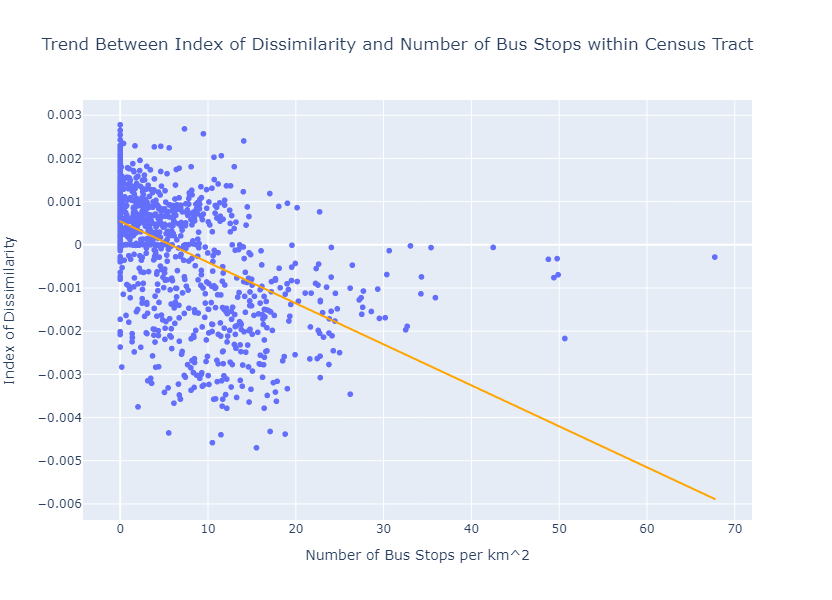

In [50]:
# Now make a scatter plot that shows the relation between the WhiteBlack Dissimilarity and Number of Bus Stops
px.scatter(y = busStopsbyTract_dissim['WhiteBlack Dissimilarity'],
           x = busStopsbyTract_dissim['Number of Bus Stops per km^2'],
           width = 1000,
           height = 600,
           labels= {'y':'Index of Dissimilarity', 'x':'Number of Bus Stops per km^2'},
           title = " Trend Between Index of Dissimilarity and Number of Bus Stops within Census Tract",
           trendline = "ols",
           trendline_color_override = "orange")

In [51]:
busStopsbyTract_dissim.sample(2)

,TRACTCE,Number of Bus Stops,WhiteBlack Dissimilarity,ALAND,Number of Bus Stops per km^2,Residual,Index of Dissimilarity
269,575200,5,0.000882,1951660,2.561922,0.001669,NaN
880,122700,0,0.001089,16293909,0.000000,0.000000,0.0


In [52]:
# Now we have to merge the residual data with metroDetroitTracts_dissimRace data so that we can map it out
metroDetroitTracts_dissimRace = pd.merge(metroDetroitTracts_dissimRace, busStopsbyTract_dissim[['TRACTCE', 'Residual']], on='TRACTCE', suffixes=('_left', '_right'))
metroDetroitTracts_dissimRace

,TRACTCE,FIPS,geometry,County,Total Population,White,Black,Native American,Asian,Pacific Islander,...,PCT_Black,PCT_White,PCT_Asian,PCT_Hispanic,WhiteBlack Dissimilarity,WhiteAsian Dissimilarity,WhiteHispanic Dissimilarity,Residual_left,Residual_right,Residual
0,591900,26163591900,"POLYGON ((-83.24385 42.08143, -83.24375 42.081...",Wayne,5305,4115,504,166,139,2,...,9.500471,77.568332,2.620170,6.446748,0.001222,0.001149,0.000043,0.000000,0.000000,0.000000
1,592000,26163592000,"POLYGON ((-83.23187 42.07831, -83.23075 42.079...",Wayne,4689,3732,323,138,188,6,...,6.888462,79.590531,4.009384,5.523566,0.001239,0.000790,0.000289,0.000000,0.000000,0.000000
2,593200,26163593200,"POLYGON ((-83.25654 42.15356, -83.25327 42.153...",Wayne,3931,3045,303,79,162,4,...,7.707962,77.461206,4.121089,7.682524,0.000972,0.000610,-0.000207,0.000000,0.000000,0.000000
3,594000,26163594000,"POLYGON ((-83.18951 42.14131, -83.18868 42.142...",Wayne,2532,2151,117,71,32,1,...,4.620853,84.952607,1.263823,5.726698,0.000782,0.000766,0.000187,0.001891,0.001891,0.001891
4,594100,26163594100,"POLYGON ((-83.20697 42.14824, -83.20675 42.150...",Wayne,4387,3948,59,112,48,3,...,1.344883,89.993162,1.094142,4.285389,0.001586,0.001449,0.000726,0.002321,0.002321,0.002321
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1468,224201,26099224201,"POLYGON ((-82.93643 42.64269, -82.93348 42.642...",Macomb,3858,3198,251,55,207,1,...,6.505962,82.892691,5.365474,3.291861,0.001087,0.000490,0.000711,0.000000,0.000000,0.000000
1469,224101,26099224101,"POLYGON ((-82.91728 42.65786, -82.91479 42.657...",Macomb,4430,3654,332,57,234,3,...,7.494357,82.483070,5.282167,2.641084,0.001198,0.000570,0.000950,0.000000,0.000000,0.000000
1470,224202,26099224202,"POLYGON ((-82.91659 42.64316, -82.91387 42.643...",Macomb,5767,3809,1272,174,137,5,...,22.056529,66.048205,2.375585,7.109416,0.000345,0.001029,-0.000417,0.000000,0.000000,0.000000
1471,232301,26099232301,"POLYGON ((-83.06929 42.55042, -83.06832 42.550...",Macomb,4874,3509,575,44,610,6,...,11.797292,71.994255,12.515388,2.338941,0.000900,-0.001018,0.000904,0.001852,0.001852,0.001852


Text(0.5, 1.0, 'Analysis of Transit Overserved and Transit Underserved Areas')

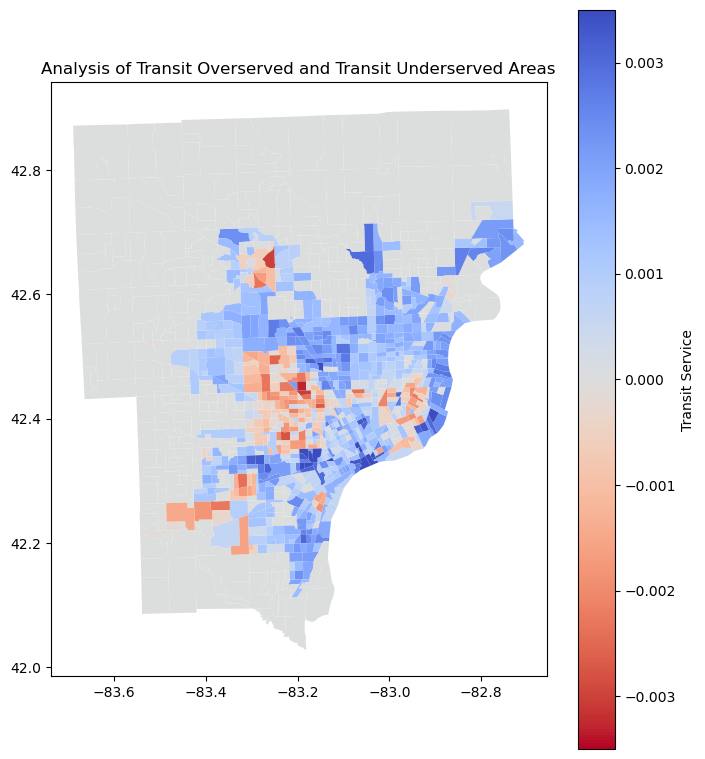

In [62]:
# Plotting out the residuals to see where the underserved and overserved
metroDetroitTracts_dissimRace.plot(figsize=(8, 9.6), 
                                   column='Residual_left', 
                                   legend=True, cmap='coolwarm_r', 
                                   legend_kwds={"label": "Transit Service"},
                                   vmin=-0.0035, vmax=0.0035)
plt.title('Analysis of Transit Overserved and Transit Underserved Areas')